SURF+Kmeans

In [1]:
import gc, argparse, sys, os, errno
%pylab inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
from tqdm import tqdm_notebook as tqdm
import scipy
import sklearn
from scipy.stats import pearsonr
import warnings
warnings.filterwarnings('ignore')
import cv2
from bokeh.palettes import Category20c

Populating the interactive namespace from numpy and matplotlib


In [3]:
cd /Users/james/Desktop/四春/A5图像处理/大作业2/DIP_final

/Users/james/Desktop/四春/A5图像处理/大作业2/DIP_final


In [6]:
ls data/Examples/0/0

56.jpg*        KeyPoints.mat*


In [25]:
#setup figure template
figure_template_path = 'bin'
if figure_template_path not in sys.path:
    sys.path.append(figure_template_path)
from importlib import reload
import figure_template
#force reload of the module
reload(figure_template)
from figure_template import display_dataframe, embed_pdf_figure, embed_pdf_pages,std_plot,legendhandle

In [11]:
def plot_img(imgfile):
    img = cv2.imread(imgfile)

    # Here I set Hessian Threshold to 2000
    # Find keypoints and descriptors directly  数量不等的关键点和64维描述子？

    SIFT = cv2.xfeatures2d_SIFT.create()
    SURF = cv2.xfeatures2d_SURF.create()

    hessian_threshold = 2000
    detector = cv2.xfeatures2d_SURF(hessian_threshold)

    # 提取特征并计算描述子
    #kps, des = cv2.xfeatures2d_SIFT.detectAndCompute(SIFT, img, None)

    # build feature detector and descriptor extractor

    hkeypoints,hdescriptors = cv2.xfeatures2d_SURF.detectAndCompute(SURF, img, None)

    # extract vectors of size 64 from raw descriptors numpy arrays
    rowsize = len(hdescriptors) / len(hkeypoints)
    if rowsize > 1:
        hrows = numpy.array(hdescriptors, dtype = numpy.float32).reshape((-1, rowsize))
        #print hrows.shape, nrows.shape
    else:
        hrows = numpy.array(hdescriptors, dtype = numpy.float32)
        rowsize = len(hrows[0])
    # kNN training - learn mapping from hrow to hkeypoints index
    samples = hrows
    responses = numpy.arange(len(hkeypoints), dtype = numpy.float32)
    #print len(samples), len(responses)
    knn = cv2.ml.KNearest_create()
    knn.train(samples,cv2.ml.ROW_SAMPLE,responses)

    # retrieve index and value through enumeration
    for i, descriptor in enumerate(hrows):
        descriptor = numpy.array(descriptor, dtype = numpy.float32).reshape((1, rowsize))
        #print i, descriptor.shape, samples[0].shape
        retval, results, neigh_resp, dists = knn.findNearest(descriptor, 1)
        res, dist =  int(results[0][0]), dists[0][0]
        #print res, dist

        if dist < 0.1:
            # draw matched keypoints in red color
            color = (0, 0, 255)
        else:
            # draw unmatched in blue color
            color = (255, 0, 0)
        # draw matched key points on haystack image
        x,y = hkeypoints[res].pt
        center = (int(x),int(y))
        cv2.circle(img,center,2,color,-1)
    return img

In [22]:
from glob import glob

In [23]:
for i in tqdm(glob('data/Examples/*/*/*.jpg')):
    _,_,tmpclassind,tmpcontextind,_ = i.split('/')
    cv2.imwrite('data/Examples/surf_'+tmpclassind+'_'+tmpcontextind+'.jpg',plot_img(i))

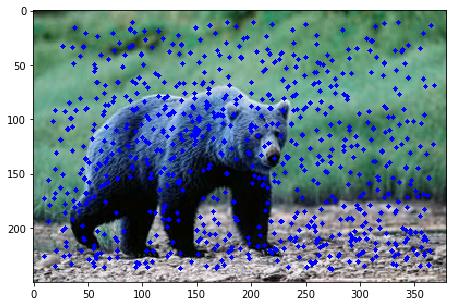

In [14]:
fig,ax=plt.subplots(1,figsize=(10,5))
imshow(plot_img('data/Examples/0/1/21.jpg'))

In [27]:
fig,ax=plt.subplots(10,10,figsize=(100,80))
for i in glob('data/Examples/surf/*.jpg'):
    _,tmpclassind,tmpcontextind = i.split('_')
    tmpcontextind = tmpcontextind.split('.')[0]
    ax[int(tmpclassind),int(tmpcontextind)].imshow(imread(i))
embed_pdf_figure()